In [ ]:
!conda install -y psycopg2

In [1]:
import psycopg2 as pg2
from psycopg2.extras import RealDictCursor
import pandas as pd
from tqdm import tqdm
import psycopg2

In [2]:
from sklearn.linear_model import LogisticRegression, Lasso, SGDRegressor
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from tqdm import tqdm
from sklearn.feature_selection import SelectKBest, RFE, SelectFromModel
from sklearn.decomposition import PCA
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.svm import SVC, SVR
%matplotlib inline

In [3]:
BATCH_SIZE = 500
SAMPLE_SIZE = 20000
SAMPLE_PERCENT = 1

con = pg2.connect(host='34.211.227.227',dbname='postgres', user='postgres')

madelon = []

r=1
pbar = tqdm(total=r)
#while True:
for i in range(r):   
    cur = con.cursor(cursor_factory=RealDictCursor, name='madelon_cursor')
    cur.execute('SELECT * FROM madelon TABLESAMPLE SYSTEM ({});'.format(SAMPLE_PERCENT))
    records = cur.fetchall()
#    print(len(records))
    cur.close()
#    if not records:
#        break

    madelon += records
    pbar.update(1)

#cur.close() 
con.close()
pbar.close()

madelon_df1 = pd.DataFrame(madelon)


100%|██████████| 1/1 [00:14<00:00, 14.72s/it]


In [4]:
madelon_df = madelon_df1
madelon_df.set_index('_id', inplace = True)
madelon_df.shape

(2023, 1001)

In [5]:
madelon_df.sample(20)

,feat_000,feat_001,feat_002,feat_003,feat_004,feat_005,feat_006,feat_007,feat_008,feat_009,...,feat_991,feat_992,feat_993,feat_994,feat_995,feat_996,feat_997,feat_998,feat_999,target
_id,,,,,,,,,,,,,,,,,,,,,
85646,1.527285,0.122055,-0.856634,0.296759,-0.567137,-0.075312,0.567760,0.188178,0.271388,-1.241173,...,-0.238252,1.476451,-1.415921,0.414497,0.751349,-0.406010,-1.052635,-0.523214,-1.059045,1
56063,0.205627,-0.264268,2.138208,-0.564998,0.588262,0.801479,0.224134,1.408178,-1.149562,0.514512,...,-0.315131,0.381181,-1.479995,0.323497,1.372128,0.891161,-0.185708,0.446065,1.074953,0
161019,2.178760,-0.022057,-0.482213,0.790437,0.926692,0.816900,-0.283995,-0.919318,-0.115389,0.205473,...,-0.725034,-0.145030,0.812167,1.168589,0.755607,-0.367178,-0.890894,0.781523,-1.383688,1
45736,-0.434479,-1.466875,0.757233,1.144495,1.533566,0.601924,0.710449,1.277939,0.123637,-0.912350,...,-0.143556,-0.349619,1.454215,0.529312,0.304296,0.203288,-0.222115,-0.166512,0.369395,0
78343,-0.623282,0.922194,-0.656753,0.231027,-0.203448,1.308468,-0.577144,-0.139317,2.316132,0.520821,...,-0.876183,0.321788,-0.586738,-0.456367,-1.115127,-3.267061,-0.006759,-0.496676,-0.991580,1
1154,2.638010,-0.070187,-1.486501,-0.166126,0.100855,0.187716,-0.035135,-0.868574,0.190141,-1.082404,...,1.716061,-1.116840,-1.302052,-1.062540,2.314429,0.556077,0.697709,-0.213497,1.173828,0
31925,0.833320,0.898616,1.879772,-0.441851,0.929991,0.129194,0.735431,-0.437972,-1.093026,-0.862885,...,-0.049995,-0.676083,-0.482719,-0.623959,-0.133082,0.111036,0.379695,0.757362,-0.581665,1
165144,1.012652,0.371086,-1.048478,1.328471,0.304177,0.399932,-0.529962,0.759344,0.030426,0.887438,...,-1.474983,0.046378,-2.000913,-0.870830,0.818456,-1.194672,-0.562616,-0.967328,-0.242343,1
42068,-0.171428,1.041475,1.165144,0.320755,-0.076560,-1.877058,0.229607,-0.363962,-0.281852,-0.894564,...,0.984834,1.311556,-1.553788,-0.550279,-0.226727,-0.653820,-2.209311,-0.004690,0.449567,0


In [6]:
madelon_df.describe()

,feat_000,feat_001,feat_002,feat_003,feat_004,feat_005,feat_006,feat_007,feat_008,feat_009,...,feat_991,feat_992,feat_993,feat_994,feat_995,feat_996,feat_997,feat_998,feat_999,target
count,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,...,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000,2023.000000
mean,0.001291,0.001911,0.023484,-0.007860,0.021770,-0.012526,0.000113,0.011480,0.003702,0.006268,...,0.051867,-0.022687,-0.033284,-0.014929,-0.018929,0.014332,-0.030621,0.003982,-0.028553,0.492338
std,1.001627,1.008659,1.016902,0.982760,1.024232,0.994258,0.981977,1.000253,0.989780,0.991185,...,0.994426,1.017585,1.037184,1.003828,1.016317,1.019371,0.959461,1.003440,0.993258,0.500065
min,-4.169672,-4.023734,-3.705663,-3.167189,-3.298943,-3.260929,-3.238295,-2.910420,-3.497315,-3.295179,...,-3.100567,-3.649041,-3.132415,-3.050971,-3.270359,-3.267061,-3.613054,-3.378677,-3.073830,0.000000
25%,-0.654449,-0.665807,-0.631314,-0.693151,-0.647573,-0.661598,-0.657878,-0.675561,-0.660540,-0.655698,...,-0.614382,-0.707421,-0.730914,-0.706160,-0.717523,-0.669884,-0.677728,-0.651064,-0.702198,0.000000
50%,0.012936,0.006640,0.019960,-0.012640,0.026510,-0.013639,-0.008188,-0.005013,0.004347,0.006453,...,0.049912,-0.042180,-0.040242,-0.057749,-0.013387,0.020769,-0.021011,-0.019142,-0.046422,0.000000
75%,0.660580,0.682221,0.689947,0.698421,0.677380,0.622989,0.650320,0.675026,0.640433,0.669553,...,0.714291,0.673369,0.687284,0.663242,0.663846,0.653868,0.643782,0.672448,0.648561,1.000000
max,3.278567,3.719992,3.468548,3.303814,3.422040,3.348106,3.375564,4.068882,3.918439,4.143126,...,3.638436,3.191896,2.884673,3.020343,3.709708,3.326398,2.992905,3.932557,3.728568,1.000000


In [7]:
madelon_df_sam = madelon_df1.sample(2000, random_state= 42)
madelon_df_sam.head()

,feat_000,feat_001,feat_002,feat_003,feat_004,feat_005,feat_006,feat_007,feat_008,feat_009,...,feat_991,feat_992,feat_993,feat_994,feat_995,feat_996,feat_997,feat_998,feat_999,target
_id,,,,,,,,,,,,,,,,,,,,,
68533,-0.630045,0.213465,1.104241,-1.105623,1.125346,-1.536484,-0.901511,-1.524168,1.785515,0.440344,...,0.900814,0.690987,-0.320708,1.339026,-0.088060,0.390511,-1.737005,0.247119,-1.001494,0
97367,0.726554,2.284151,2.036935,0.789258,-0.250066,-0.263056,-0.743472,-0.709374,-0.967125,0.412569,...,0.198238,0.257084,0.984807,0.088130,0.423509,1.155878,-0.977794,-1.176328,-0.706565,1
73168,1.104794,1.227246,0.732419,-1.011947,-1.663433,-0.456679,0.640422,-1.478778,1.713061,-1.162793,...,0.587830,1.344042,2.544894,-0.891755,-1.695282,1.579626,-1.783270,0.580528,-0.276392,1
61401,-1.083579,-0.798609,-0.317092,1.085056,-0.059039,-0.773248,0.011502,-1.175655,0.887770,0.437816,...,0.846085,0.365114,0.929547,0.413336,-1.250767,0.419601,0.089420,0.601621,-0.213122,1
60111,-1.773429,0.147115,-0.868857,0.931942,-0.192645,1.023371,-1.407601,-0.132020,0.192965,0.428466,...,-0.701260,-0.773859,-0.554952,-0.261914,0.508681,0.797000,-1.198047,-0.881768,0.934235,1


In [8]:
target= madelon_df_sam['target']
madelon_df_sam.drop(['target'], axis=1, inplace= True)

In [9]:
#target.head()

In [43]:
#madelon_df_sam.head()

## Feature Selection: 
1) Iterative unsupervised method to get R2 for each column. I am going to use DecisionTreeRegressor, KNneighborRegresssor, SVR, SGDRegressor as an estimator and find out features that are important.


In [10]:
def iterative_score(df, model):
    '''This function takes a df without target, converts one column of df to target and
    takes the remining df wihtout the target column as X predictors. Gets train and test samples
    It takes a model which will be used to fit and score the test set.'''
    model = model()
    scores = {}
    for col in tqdm(df.columns):
        df_fresh = df
        target = df_fresh[col]
        df_fresh = df_fresh.drop(col, axis=1)
        
        x_train, x_test, target_train, target_test = train_test_split(df_fresh,\
                                                                      target, test_size = 0.3)
        model.fit(x_train, target_train)
        score = model.score(x_test, target_test)
        scores[col] = score
    return scores

In [11]:
#DecisionTreeRegressor estimator
DTscore = iterative_score(madelon_df_sam, DecisionTreeRegressor)

100%|██████████| 1000/1000 [28:21<00:00,  1.70s/it]


In [12]:
DTscores = pd.DataFrame()
DTscores['Feature'] = DTscore.keys()
DTscores['Score'] = DTscore.values()
DTscores.columns

Index(['Feature', 'Score'], dtype='object')

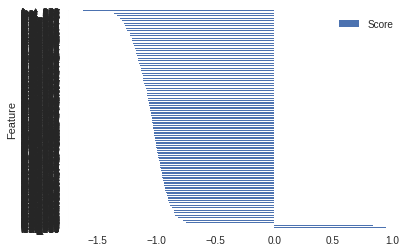

In [20]:
DTscores.iloc[:,:100].sort_values('Score',ascending=False).plot.barh(x='Feature')

In [58]:
scatter = sns.pairplot(DTscores.sort('Score')[:, :20])
scatter

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  """Entry point for launching an IPython kernel.


TypeError: unhashable type: 'slice'

In [30]:
DTscores[DTscores['Score'] > 0]

,Feature,Score
257,feat_257,0.821071
269,feat_269,0.910944
308,feat_308,0.796622
315,feat_315,0.879696
336,feat_336,0.863809
341,feat_341,0.883473
395,feat_395,0.871767
504,feat_504,0.779948
526,feat_526,0.765129
639,feat_639,0.963489


In [31]:
#KNeighborRegressor estimator
KNscore = iterative_score(madelon_df_sam, KNeighborsRegressor)

100%|██████████| 1000/1000 [25:37<00:00,  1.54s/it]


In [33]:
KNscores = pd.DataFrame()
KNscores['Feature'] = KNscore.keys()
KNscores['Score'] = KNscore.values()

In [34]:
KNscores.sort('Score', ascending= False, inplace= True)
KNscores[KNscores['Score'] > 0.1]

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  """Entry point for launching an IPython kernel.


,Feature,Score
639,feat_639,0.783718
341,feat_341,0.772463
956,feat_956,0.769165
315,feat_315,0.740081
867,feat_867,0.705952
269,feat_269,0.701858
336,feat_336,0.697162
724,feat_724,0.691109
395,feat_395,0.681278
701,feat_701,0.669706


In [1]:
KNscores.sort_values('Score',ascending=False).plot.bar(x='Feature')

NameError: name 'KNscores' is not defined

In [70]:
KNscores.plot.barh(x='Score', y='Feature')

TypeError: Empty 'DataFrame': no numeric data to plot

In [32]:
SVRscore = iterative_score(madelon_df_sam, SVR) #really slow

100%|██████████| 1000/1000 [48:04<00:00,  2.88s/it]


In [35]:
#Support Vector Regressor estimator
SVRscores = pd.DataFrame()
SVRscores['Feature'] = SVRscore.keys()
SVRscores['Score'] = SVRscore.values()

In [36]:
SVR_column = SVRscores.sort('Score', ascending = False)
SVR_column.head(20)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  """Entry point for launching an IPython kernel.


,Feature,Score
639,feat_639,0.975104
341,feat_341,0.968910
956,feat_956,0.966134
269,feat_269,0.953727
867,feat_867,0.953627
336,feat_336,0.948836
315,feat_315,0.948507
724,feat_724,0.946169
701,feat_701,0.943713
257,feat_257,0.943620


In [37]:
#SGDRegressor estimator
SGDscore = iterative_score(madelon_df_sam, SGDRegressor)

  0%|          | 0/1000 [00:00<?, ?it/s]/opt/conda/lib/python3.6/site-packages/sklearn/linear_model/stochastic_gradient.py:128: FutureWarning: max_iter and tol parameters have been added in <class 'sklearn.linear_model.stochastic_gradient.SGDRegressor'> in 0.19. If both are left unset, they default to max_iter=5 and tol=None. If tol is not None, max_iter defaults to max_iter=1000. From 0.21, default max_iter will be 1000, and default tol will be 1e-3.
  "and default tol will be 1e-3." % type(self), FutureWarning)
100%|██████████| 1000/1000 [01:01<00:00, 16.15it/s]


In [38]:
SGDscores = pd.DataFrame()
SGDscores['Feature'] = SGDscore.keys()
SGDscores['Score'] = SGDscore.values()

In [39]:
SGDscores.sort('Score', ascending = False)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  """Entry point for launching an IPython kernel.


,Feature,Score
341,feat_341,0.959015
336,feat_336,0.958666
269,feat_269,0.955601
724,feat_724,0.953642
701,feat_701,0.951435
920,feat_920,0.941091
867,feat_867,0.935914
395,feat_395,0.934385
257,feat_257,0.932177
639,feat_639,0.929406


## Run RandomForest for feature selection

In [40]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV 
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

In [41]:
rf_pipe = Pipeline([
    ('scaler',StandardScaler()),
    ('clf',RandomForestClassifier(random_state=42))
])

rfparams = {
    'clf__n_estimators':[10, 50,100],
    'clf__max_features':['auto','log2']
}

In [42]:
gs_rf = GridSearchCV(rf_pipe, rfparams, cv= 5, n_jobs= -1)

In [43]:
gs_rf.fit(madelon_df_sam, target)

GridSearchCV(cv=5, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('scaler', StandardScaler(copy=True, with_mean=True, with_std=True)), ('clf', RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decreas...timators=10, n_jobs=1,
            oob_score=False, random_state=42, verbose=0, warm_start=False))]),
       fit_params=None, iid=True, n_jobs=-1,
       param_grid={'clf__n_estimators': [10, 50, 100], 'clf__max_features': ['auto', 'log2']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [44]:
rf_feature = gs_rf.best_estimator_.named_steps['clf'].feature_importances_

In [45]:
#gs_rf.grid_scores_

In [46]:
rf_importance = pd.DataFrame(list(zip(madelon_df_sam.columns, rf_feature))).rename(columns={0:'feature',1:'importance'})

In [47]:
rf_importance.sort('importance', ascending= False)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  """Entry point for launching an IPython kernel.


,feature,importance
269,feat_269,0.014127
681,feat_681,0.008211
769,feat_769,0.007475
701,feat_701,0.006980
395,feat_395,0.006167
315,feat_315,0.005837
341,feat_341,0.005703
724,feat_724,0.005336
920,feat_920,0.004973
829,feat_829,0.004677


## running RFE without n_features_to_select

In [48]:
rfe1 = RFE(Lasso(), n_features_to_select=100)

In [49]:
rfe1.fit_transform(madelon_df_sam, target)

array([[ 1.23187884,  0.77734699, -0.78610966, ...,  0.32722882,
        -0.54779463,  0.26146169],
       [ 0.29286932, -0.01067426, -0.99849851, ...,  0.15859565,
         1.58531682,  3.70758621],
       [-0.117156  ,  1.18277509, -0.46582325, ..., -0.9154868 ,
         0.53617044,  0.32651952],
       ..., 
       [-1.19255072,  0.16901043,  0.55786418, ...,  0.3091504 ,
        -0.76170721, -1.61872903],
       [ 0.86717199,  1.75051831,  1.797074  , ..., -0.15130211,
         0.91978701,  0.02019543],
       [ 0.48902892,  0.73820593, -0.40486858, ...,  0.25196161,
        -0.1579608 , -0.48944316]])

In [50]:
rfe1.get_support(indices = True)

array([900, 901, 902, 903, 904, 905, 906, 907, 908, 909, 910, 911, 912,
       913, 914, 915, 916, 917, 918, 919, 920, 921, 922, 923, 924, 925,
       926, 927, 928, 929, 930, 931, 932, 933, 934, 935, 936, 937, 938,
       939, 940, 941, 942, 943, 944, 945, 946, 947, 948, 949, 950, 951,
       952, 953, 954, 955, 956, 957, 958, 959, 960, 961, 962, 963, 964,
       965, 966, 967, 968, 969, 970, 971, 972, 973, 974, 975, 976, 977,
       978, 979, 980, 981, 982, 983, 984, 985, 986, 987, 988, 989, 990,
       991, 992, 993, 994, 995, 996, 997, 998, 999])

In [51]:
rfe_df = pd.DataFrame()
rfe_df['Feature'] =pd.Series(madelon_df_sam.columns)
rfe_df['Rank'] = pd.Series(rfe1.ranking_)
rfe_df.sort('Rank')

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:4: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  after removing the cwd from sys.path.


,Feature,Rank
999,feat_999,1
926,feat_926,1
927,feat_927,1
928,feat_928,1
929,feat_929,1
930,feat_930,1
931,feat_931,1
932,feat_932,1
933,feat_933,1
934,feat_934,1


## SelectKBest feature selection 

In [52]:
sk = SelectKBest(k=100)
sk.fit(madelon_df_sam, target)

SelectKBest(k=100, score_func=<function f_classif at 0x7f384856c8c8>)

In [53]:
sk.get_support(indices=True)

array([ 11,  41,  42,  48,  64,  69,  70,  84,  96,  98,  99, 138, 145,
       168, 182, 188, 189, 215, 218, 231, 257, 269, 280, 292, 296, 298,
       303, 313, 315, 334, 336, 341, 351, 355, 371, 394, 395, 427, 430,
       444, 445, 451, 453, 456, 462, 464, 474, 480, 496, 504, 513, 522,
       530, 554, 568, 582, 621, 631, 638, 646, 655, 659, 675, 681, 693,
       701, 704, 707, 708, 713, 724, 736, 742, 756, 769, 774, 776, 784,
       788, 793, 802, 808, 824, 829, 847, 862, 867, 873, 879, 887, 897,
       915, 920, 943, 945, 964, 976, 989, 992, 996])

In [54]:
sk_df = pd.DataFrame()
sk_df['Feature'] = sk.get_support(indices=True)
sk_df['F-score'] = sk.scores_[sk.get_support(indices=True)]
sk_df['p-values'] = sk.pvalues_[sk.get_support(indices=True)]

In [76]:
sk_df.sort('F-score', ascending= False, inplace =True)
#sk_df

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  """Entry point for launching an IPython kernel.


## EDA on the selected 20 feature from iterative unsupervised method:

In [71]:
#DTscores.sort('Score', ascending= False)[:20].Feature

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  
/opt/conda/lib/python3.6/site-packages/matplotlib/axes/_axes.py:545: UserWarning: No labelled objects found. Use label='...' kwarg on individual plots.
  warnings.warn("No labelled objects found. "


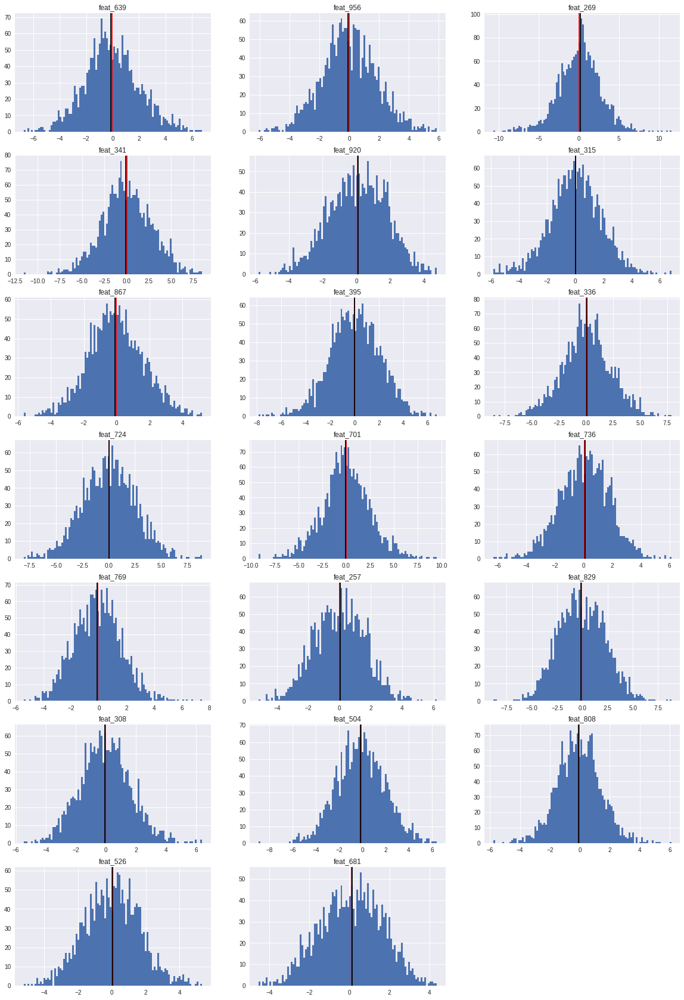

In [70]:
#histogram of features selected from DesicionTree to check their skew and distribution.
#think I do not have to deskew and scale the data.
figure = plt.figure(figsize= (20,30))
for index, col in enumerate(DTscores.sort('Score', ascending= False)[:20].Feature):
    plt.subplot(7,3,1+index)
    plt.hist(madelon_df_sam[col], bins = 100)
    plt.axvline(madelon_df_sam[col].mean(), c='red')
    plt.axvline(madelon_df_sam[col].median(), c='black')
    plt.title(col)
    plt.legend()

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  """Entry point for launching an IPython kernel.


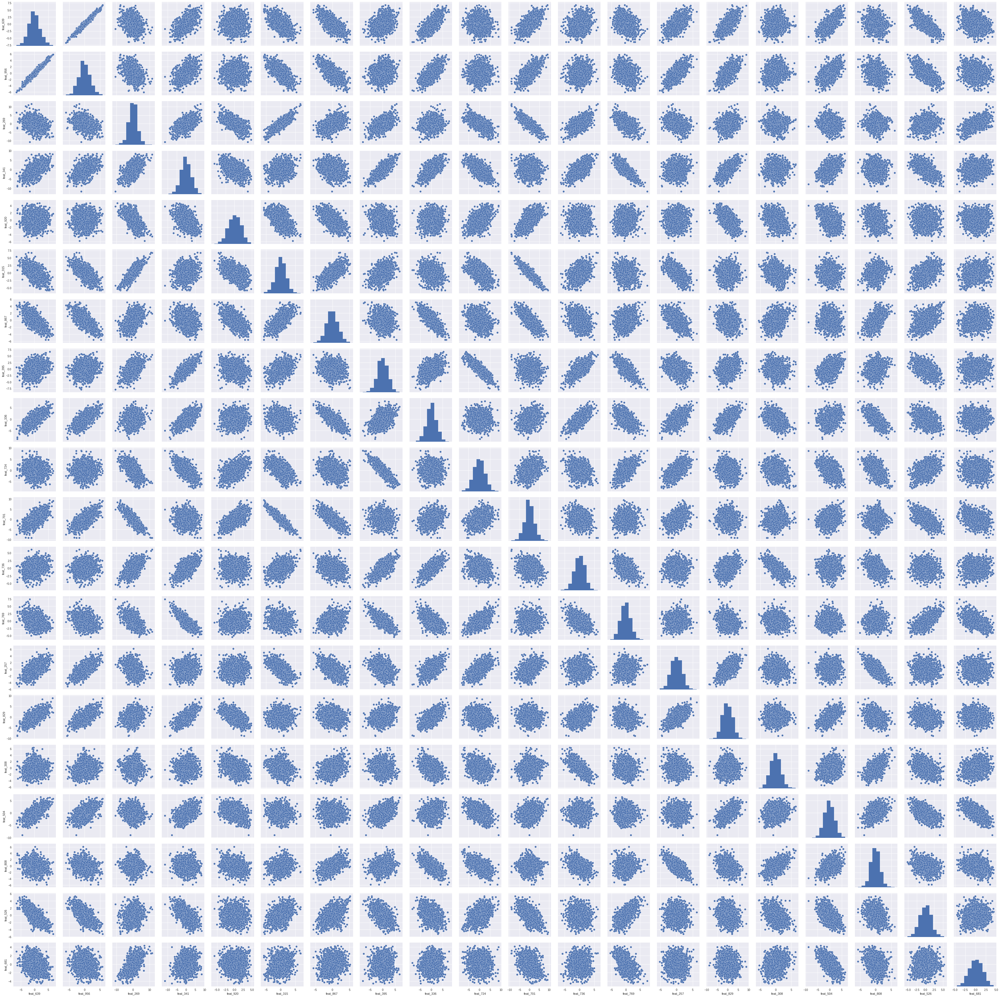

In [72]:
scatter = sns.pairplot(madelon_df_sam[DTscores.sort('Score', ascending= False)[:20].Feature])
scatter

Features, 639, 956, 701 seems very decisive.

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  


NameError: name 'scatter2' is not defined

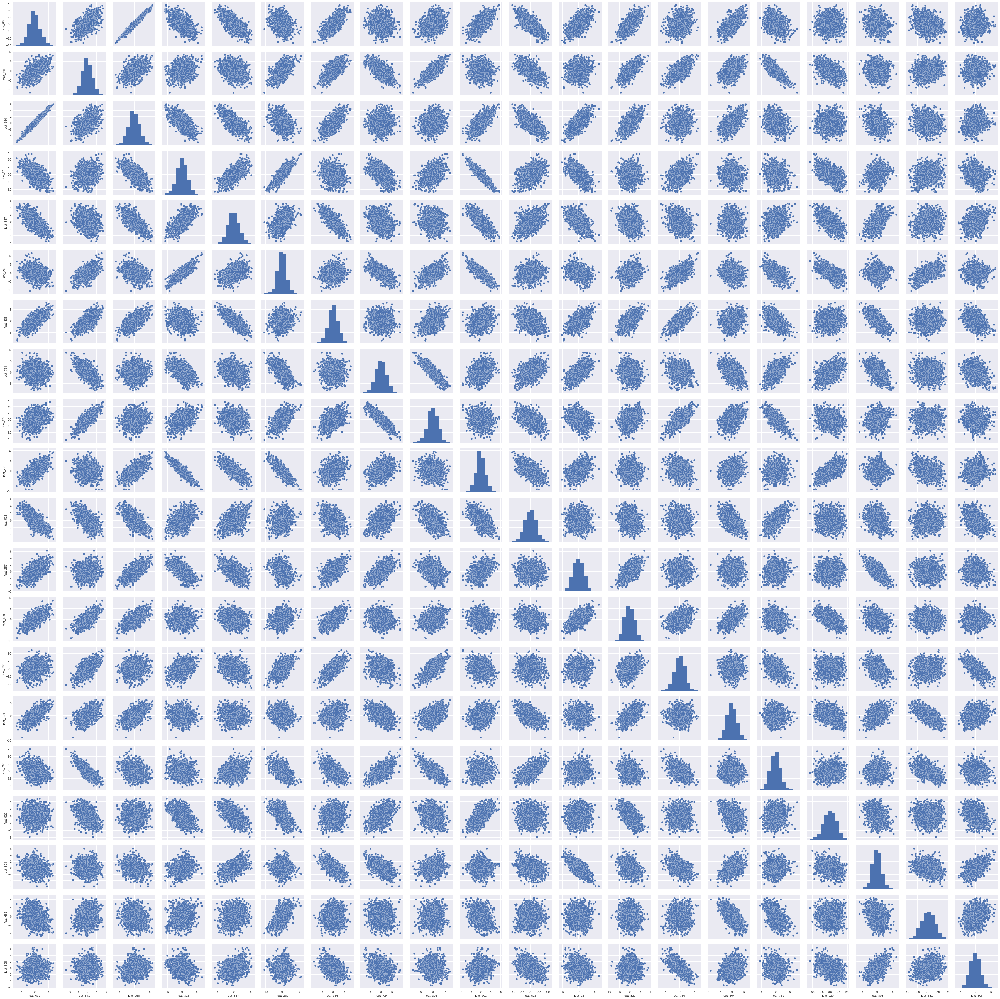

In [73]:
# features selected from KNeighborRegressor
scatter1 = sns.pairplot(madelon_df_sam[KNscores.sort('Score', ascending= False)[:20].Feature])
scatter1

Feature 956, 639, 701

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  """Entry point for launching an IPython kernel.


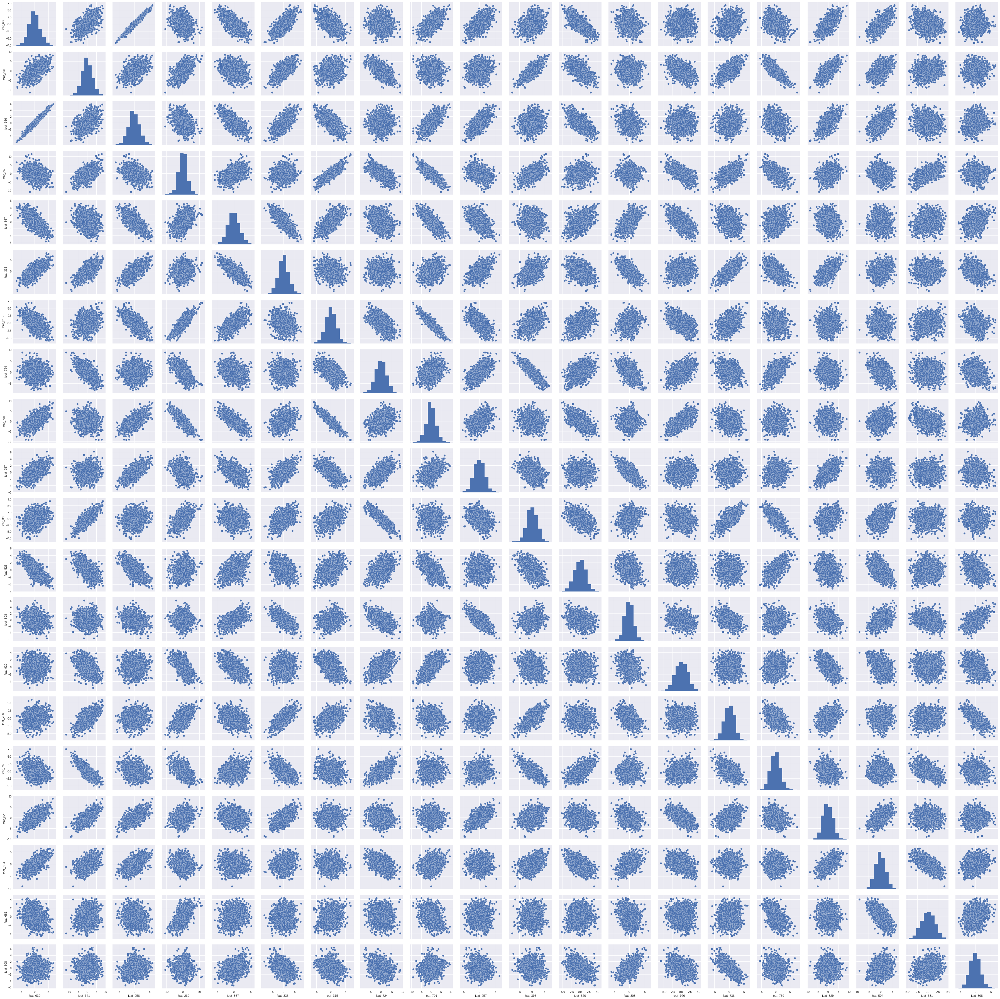

In [74]:
#SGDRegressor features pairplot
sns.pairplot(madelon_df_sam[SVRscores.sort('Score', ascending= False)[:20].Feature])


Features 956, 639, 701, 769

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: sort(columns=....) is deprecated, use sort_values(by=.....)
  


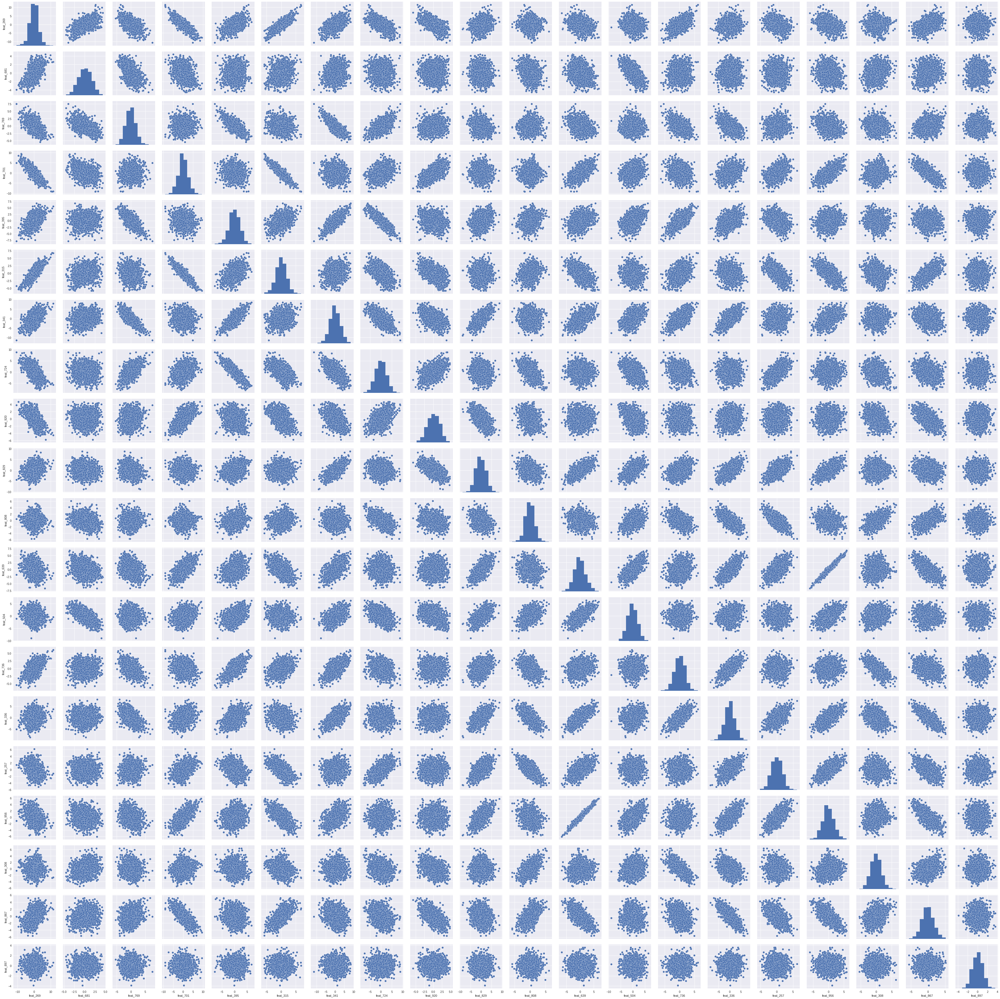

In [82]:
# features selected from supervised RandomForestClassifier
sns.pairplot(madelon_df_sam[rf_importance.sort('importance', ascending= False)[:20].feature])

feature 701, 639, 956, 341

In [ ]:
ma